In [1]:
#%pip install -U -q dtreeviz seaborn yellowbrick
#%pip install -U kaleido

## Importar pacotes

In [2]:
#importar numpy para trabalhar com matrizes e pandas para ler dados no formato frame
import numpy as np
import pandas as pd

#importar o pacote datasets do scikit-learn para carregar conjuntos de dados
from sklearn import datasets

#importar KMeans para fazer o agrupamento
from sklearn.cluster import KMeans

#importar o módulo pyplot para plotar o gráfico no método do cotovelo
import matplotlib.pyplot as plt

# create report
from dataprep.eda import create_report

# Para normalizar
from sklearn.preprocessing import MinMaxScaler

# plotly
import plotly.io as pio
#pio.renderers.default='notebook'
pio.renderers.default='svg'
import plotly.express as px
layout = {
  'width': 1410,
  'height': 525
}

# Desabilitar warnings
import warnings
warnings.filterwarnings('ignore')
import logging
logging.disable(logging.INFO)

# K-Means - Método do Cotovelo

## Mines Dataset

  - https://archive.ics.uci.edu/dataset/763/land+mines-1
  - Base de dados de detecção de minas terrestres.
  - Escolhi essa base de dados por ter poucos atributos ser mais fácil de visualizar o funcionamento do algoritmo.
  - A base já está normalizada e, por isso, por ser fácil demais, optei por utilizar duas bases diferentes para a realização desse exercício.

In [3]:
df = pd.read_csv('minedataset.csv')

In [4]:
display(df.info())
display(df.head(4))

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 338 entries, 0 to 337
Data columns (total 4 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   voltage  338 non-null    float64
 1   height   338 non-null    float64
 2   soil     338 non-null    float64
 3   mine     338 non-null    int64  
dtypes: float64(3), int64(1)
memory usage: 10.7 KB


None

,voltage,height,soil,mine
0,0.338157,0.000000,0.0,1
1,0.320241,0.181818,0.0,1
2,0.287009,0.272727,0.0,1
3,0.256284,0.454545,0.0,1


## Análise Descritiva

Dados presentes:
  - voltage: voltagem medida no sensor.
  - height: altura da medição.
  - soil: tipo de solo.
    - 1: seco e arenoso.
    - 2: seco e humus
    - 3: seco e calcário
    - 4: úmido e arenoso.
    - 5: úmido e humus
    - 6: úmido e calcário
  - mine: tipo de mina (variável que se deseja descobrir na clusterização)
    - 1: nulo
    - 2: anti tanque
    - 3: antipessoal
    - 4: armadilha antipessoal
    - 5: M14 antipessoal

  0%|          | 0/614 [00:00<?, ?it/s]

DataPrep Report
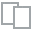
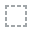
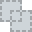
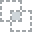
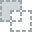
...
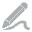
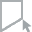
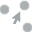
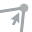
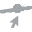

In [5]:
create_report(df)

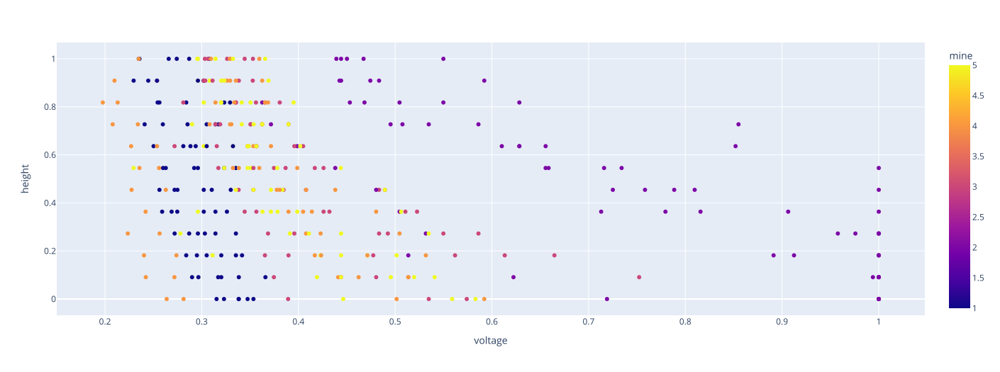

In [6]:
px.scatter(df, x='voltage', y='height', color='mine', **layout)

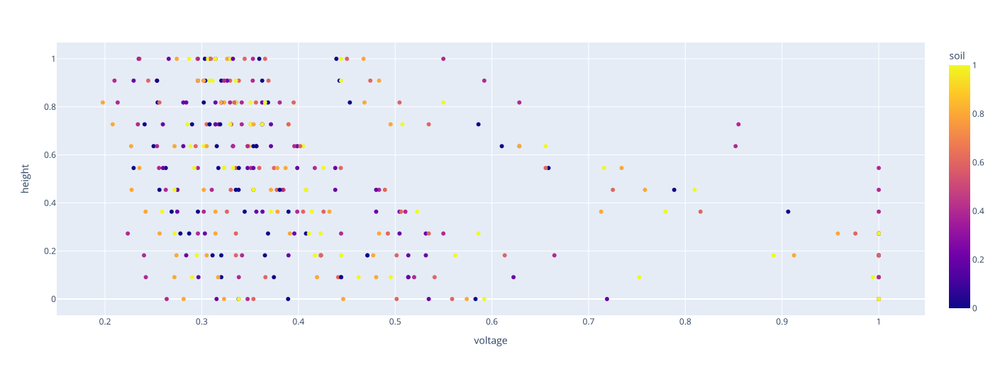

In [7]:
px.scatter(df, x='voltage', y='height', color='soil', **layout)

In [8]:
#Definir a lista de atributos categóricos e atributos contínuos
categorical_features = ['soil']
continuous_features = ['voltage', 'height']

#Transformar atributos categóricos em binários com a função get_dummies()
for col in categorical_features:
    dummies = pd.get_dummies(df[col], prefix=col)
    df = pd.concat([df, dummies], axis=1)
    df.drop(col, axis=1, inplace=True)
df.head()

,voltage,height,mine,soil_0.0,soil_0.2,soil_0.4,soil_0.6,soil_0.8,soil_1.0
0,0.338157,0.000000,1,1,0,0,0,0,0
1,0.320241,0.181818,1,1,0,0,0,0,0
2,0.287009,0.272727,1,1,0,0,0,0,0
3,0.256284,0.454545,1,1,0,0,0,0,0
4,0.262840,0.545455,1,1,0,0,0,0,0


### Aplicando o método do cotovelo

In [9]:
df_transformed = pd.DataFrame(df)
#df_transformed = pd.DataFrame(df[df['mine']!=1])
PESO_HEIGHT = 1
PESO_SOIL = 0.3
df_transformed['height'] = df_transformed['height']*PESO_HEIGHT
df_transformed['soil_0.0'] = df_transformed['soil_0.0']*PESO_SOIL
df_transformed['soil_0.2'] = df_transformed['soil_0.2']*PESO_SOIL
df_transformed['soil_0.4'] = df_transformed['soil_0.4']*PESO_SOIL
df_transformed['soil_0.6'] = df_transformed['soil_0.6']*PESO_SOIL
df_transformed['soil_0.8'] = df_transformed['soil_0.8']*PESO_SOIL
df_transformed['soil_1.0'] = df_transformed['soil_1.0']*PESO_SOIL

del df_transformed['mine']
K = range(1,31)

In [10]:
Sum_of_squared_distances = []
for k in K:
    km = KMeans(n_clusters=k,n_init=20)
    km = km.fit(df_transformed)
    Sum_of_squared_distances.append(km.inertia_)

Determinar quais foram os melhores índices

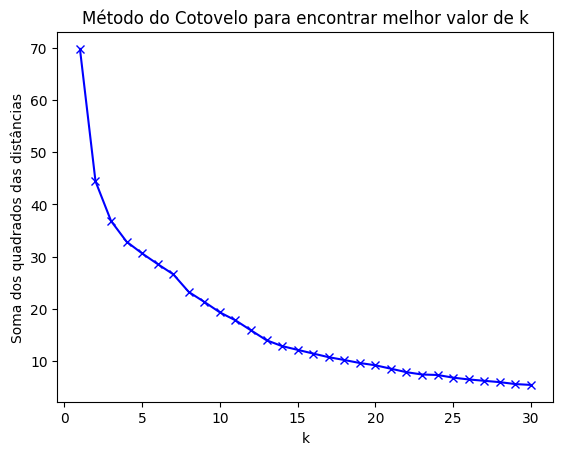

In [11]:
plt.plot(K, Sum_of_squared_distances, 'bx-')
plt.xlabel('k')
plt.ylabel('Soma dos quadrados das distâncias')
plt.title('Método do Cotovelo para encontrar melhor valor de k')
plt.show()

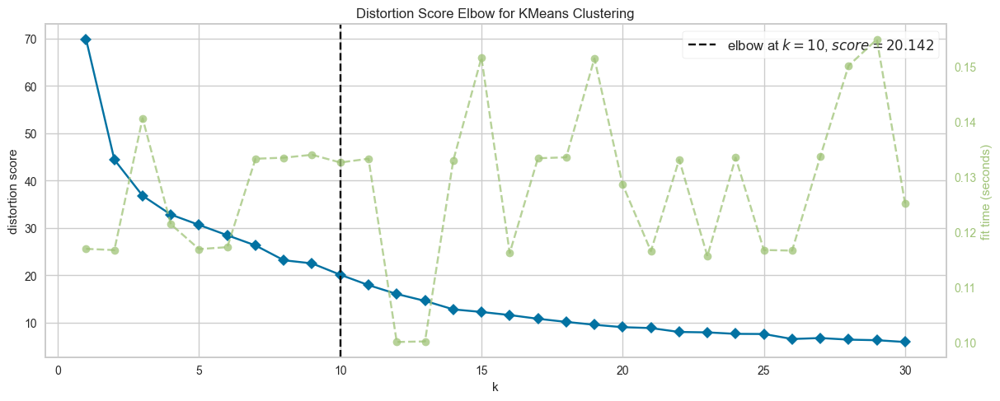

In [12]:
from yellowbrick.cluster import KElbowVisualizer
model = KMeans(n_init=20, init = 'random')
visualizer = KElbowVisualizer(model, k=K, size=(layout['width'], layout['height']))
visualizer.fit(df_transformed)
visualizer.show();

In [13]:
kBest = visualizer.elbow_value_
print(kBest)

10


In [14]:
kmeans = KMeans(n_clusters = kBest, n_init = 20, init = 'random')
kmeans.fit(df_transformed)
kmeans.cluster_centers_

array([[ 3.82240083e-01,  7.35294118e-01,  1.38777878e-17,
         0.00000000e+00, -2.08166817e-17,  3.00000000e-01,
        -2.08166817e-17,  1.38777878e-17],
       [ 3.64439362e-01,  2.37154150e-01,  3.00000000e-01,
        -6.93889390e-18,  6.93889390e-18,  6.93889390e-18,
        -2.08166817e-17,  6.93889390e-18],
       [ 3.24664985e-01,  7.51748252e-01, -1.38777878e-17,
         3.00000000e-01,  0.00000000e+00,  6.93889390e-18,
        -2.77555756e-17,  6.93889390e-18],
       [ 3.54744672e-01,  7.21590909e-01,  6.93889390e-18,
        -6.93889390e-18, -1.38777878e-17,  1.38777878e-17,
         3.00000000e-01,  1.38777878e-17],
       [ 3.62955307e-01,  7.44318182e-01,  6.93889390e-18,
        -6.93889390e-18,  3.00000000e-01,  1.38777878e-17,
        -2.08166817e-17,  1.38777878e-17],
       [ 4.33952368e-01,  2.40000000e-01, -6.93889390e-18,
         3.00000000e-01, -6.93889390e-18,  6.93889390e-18,
        -2.08166817e-17,  6.93889390e-18],
       [ 3.49481960e-01,  7.727272

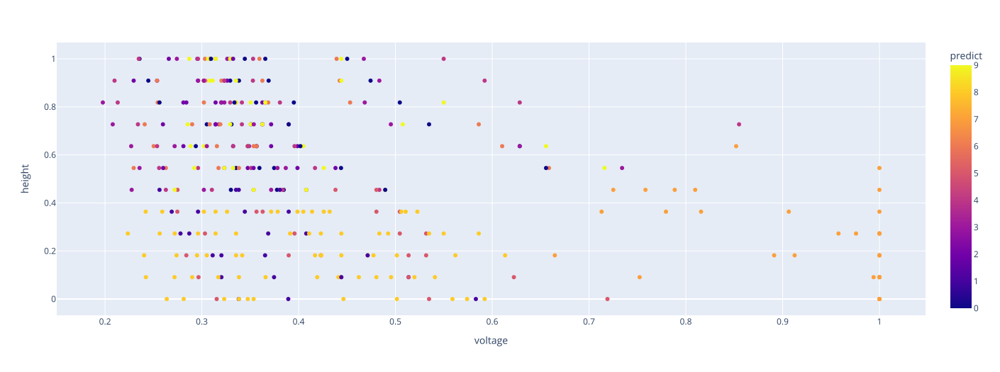

In [15]:
y_pred1 = kmeans.labels_
df_transformed['predict'] = y_pred1
px.scatter(df_transformed, x='voltage', y='height', color='predict', **layout)

  - Como pode ser observado, o resultado não conseguiu acertar de modo satisfatório o atributo 'mine'.
  - A base de dados possui muitos dados sobrepostos e, por isso, talvez não seja adequado para essa tarefa.
  - Faltam parâmetros na base de dados que podem ser importantes. Por exemplo, a profundidade em que o artefato foi encontrado.

## HCV Dataset

  - https://archive.ics.uci.edu/dataset/571/hcv+data
  - Dataset com dados de exames de sangue de doadores e de pessoas com hepatite C.

In [16]:
dfHVC = pd.read_csv('hcvdata.csv')

## Análise Descritiva

In [17]:
display(dfHVC.info())
display(dfHVC.head(4))
stats = dfHVC.describe()
stats

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 615 entries, 0 to 614
Data columns (total 14 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Unnamed: 0  615 non-null    int64  
 1   Category    615 non-null    object 
 2   Age         615 non-null    int64  
 3   Sex         615 non-null    object 
 4   ALB         614 non-null    float64
 5   ALP         597 non-null    float64
 6   ALT         614 non-null    float64
 7   AST         615 non-null    float64
 8   BIL         615 non-null    float64
 9   CHE         615 non-null    float64
 10  CHOL        605 non-null    float64
 11  CREA        615 non-null    float64
 12  GGT         615 non-null    float64
 13  PROT        614 non-null    float64
dtypes: float64(10), int64(2), object(2)
memory usage: 67.4+ KB


None

,Unnamed: 0,Category,Age,Sex,ALB,ALP,ALT,AST,BIL,CHE,CHOL,CREA,GGT,PROT
0,1,0=Blood Donor,32,m,38.5,52.5,7.7,22.1,7.5,6.93,3.23,106.0,12.1,69.0
1,2,0=Blood Donor,32,m,38.5,70.3,18.0,24.7,3.9,11.17,4.80,74.0,15.6,76.5
2,3,0=Blood Donor,32,m,46.9,74.7,36.2,52.6,6.1,8.84,5.20,86.0,33.2,79.3
3,4,0=Blood Donor,32,m,43.2,52.0,30.6,22.6,18.9,7.33,4.74,80.0,33.8,75.7


,Unnamed: 0,Age,ALB,ALP,ALT,AST,BIL,CHE,CHOL,CREA,GGT,PROT
count,615.000000,615.000000,614.000000,597.000000,614.000000,615.000000,615.000000,615.000000,605.000000,615.000000,615.000000,614.000000
mean,308.000000,47.408130,41.620195,68.283920,28.450814,34.786341,11.396748,8.196634,5.368099,81.287805,39.533171,72.044137
std,177.679487,10.055105,5.780629,26.028315,25.469689,33.090690,19.673150,2.205657,1.132728,49.756166,54.661071,5.402636
min,1.000000,19.000000,14.900000,11.300000,0.900000,10.600000,0.800000,1.420000,1.430000,8.000000,4.500000,44.800000
25%,154.500000,39.000000,38.800000,52.500000,16.400000,21.600000,5.300000,6.935000,4.610000,67.000000,15.700000,69.300000
50%,308.000000,47.000000,41.950000,66.200000,23.000000,25.900000,7.300000,8.260000,5.300000,77.000000,23.300000,72.200000
75%,461.500000,54.000000,45.200000,80.100000,33.075000,32.900000,11.200000,9.590000,6.060000,88.000000,40.200000,75.400000
max,615.000000,77.000000,82.200000,416.600000,325.300000,324.000000,254.000000,16.410000,9.670000,1079.100000,650.900000,90.000000


Dados presentes:

  - Category: categoria (variável de interesse)
  - Age: idade
  - Sex: sexo
  - ALB (feature numérica)
  - ALP (feature numérica)
  - ALT (feature numérica)
  - AST (feature numérica)
  - BIL (feature numérica)
  - CHE (feature numérica)
  - CHOL (feature numérica)
  - CREA (feature numérica)
  - GGT (feature numérica)
  - PROT (feature numérica)

As features são informações coletadas em exames sanguíneos.

  0%|          | 0/2606 [00:00<?, ?it/s]

DataPrep Report
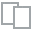
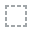
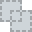
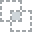
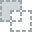
...
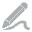
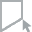
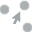
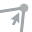
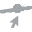

In [18]:
create_report(dfHVC)

In [19]:
## Substituir os valores nulos pela mediana.

#dfHVC[pd.isna(dfHVC['ALB'])]
dfHVC['ALB'] = dfHVC['ALB'].apply(lambda x: stats['ALB']['50%'] if pd.isna(x) else x)
#dfHVC[pd.isna(dfHVC['ALP'])]
dfHVC['ALP'] = dfHVC['ALP'].apply(lambda x: stats['ALP']['50%'] if pd.isna(x) else x)
#dfHVC[pd.isna(dfHVC['ALT'])]
dfHVC['ALT'] = dfHVC['ALT'].apply(lambda x: stats['ALT']['50%'] if pd.isna(x) else x)
#dfHVC[pd.isna(dfHVC['CHOL'])]
dfHVC['CHOL'] = dfHVC['CHOL'].apply(lambda x: stats['CHOL']['50%'] if pd.isna(x) else x)
#dfHVC[pd.isna(dfHVC['PROT'])]
dfHVC['PROT'] = dfHVC['PROT'].apply(lambda x: stats['PROT']['50%'] if pd.isna(x) else x)

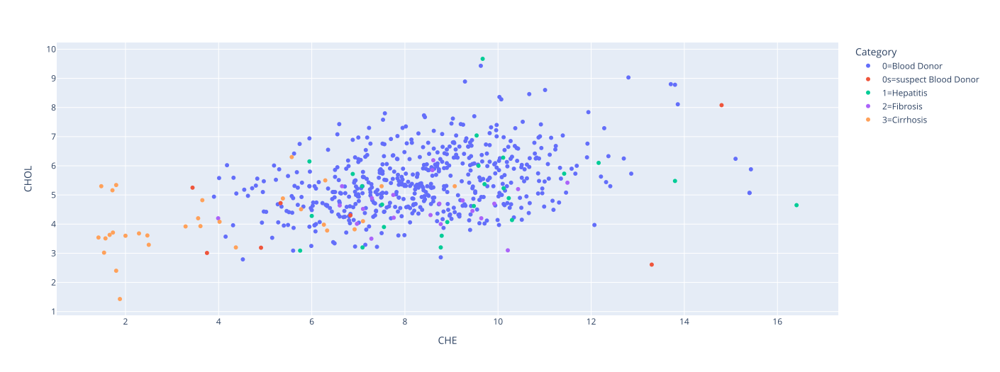

In [20]:
px.scatter(dfHVC, x='CHE', y='CHOL', color='Category', **layout)

In [21]:
#Definir a lista de atributos categóricos e atributos contínuos
categorical_features = ['Sex']
continuous_features = ['Age', 'ALB', 'ALP', 'ALT', 'AST', 'BIL', 'CHE', 'CHOL', 'CREA', 'GGT', 'PROT']

#Transformar atributos categóricos em binários com a função get_dummies()
for col in categorical_features:
    dummies = pd.get_dummies(dfHVC[col], prefix=col)
    dfHVC = pd.concat([dfHVC, dummies], axis=1)
    #dfHVC.drop(col, axis=1, inplace=True)
dfHVC.head()

,Unnamed: 0,Category,Age,Sex,ALB,ALP,ALT,AST,BIL,CHE,CHOL,CREA,GGT,PROT,Sex_f,Sex_m
0,1,0=Blood Donor,32,m,38.5,52.5,7.7,22.1,7.5,6.93,3.23,106.0,12.1,69.0,0,1
1,2,0=Blood Donor,32,m,38.5,70.3,18.0,24.7,3.9,11.17,4.80,74.0,15.6,76.5,0,1
2,3,0=Blood Donor,32,m,46.9,74.7,36.2,52.6,6.1,8.84,5.20,86.0,33.2,79.3,0,1
3,4,0=Blood Donor,32,m,43.2,52.0,30.6,22.6,18.9,7.33,4.74,80.0,33.8,75.7,0,1
4,5,0=Blood Donor,32,m,39.2,74.1,32.6,24.8,9.6,9.15,4.32,76.0,29.9,68.7,0,1


In [22]:
#normalizar os atributos contínuos com MinMaxScaler()
df_transformedHVC = pd.DataFrame(dfHVC)
del df_transformedHVC['Unnamed: 0']
del df_transformedHVC['Category']
del df_transformedHVC['Sex']

mms = MinMaxScaler()
mms.fit(df_transformedHVC)

columns = df_transformedHVC.columns
mmsTransformed = mms.transform(df_transformedHVC)
df_transformedHVC = pd.DataFrame(mmsTransformed)
df_transformedHVC.columns = columns

df_transformedHVC.head()

,Age,ALB,ALP,ALT,AST,BIL,CHE,CHOL,CREA,GGT,PROT,Sex_f,Sex_m
0,0.224138,0.350669,0.101653,0.020962,0.036694,0.026461,0.367578,0.218447,0.091495,0.011757,0.535398,0.0,1.0
1,0.224138,0.350669,0.145571,0.052713,0.044990,0.012243,0.650434,0.408981,0.061619,0.017172,0.701327,0.0,1.0
2,0.224138,0.475483,0.156427,0.108816,0.134014,0.020932,0.494997,0.457524,0.072822,0.044400,0.763274,0.0,1.0
3,0.224138,0.420505,0.100419,0.091554,0.038290,0.071485,0.394263,0.401699,0.067221,0.045328,0.683628,0.0,1.0
4,0.224138,0.361070,0.154947,0.097719,0.045310,0.034755,0.515677,0.350728,0.063486,0.039295,0.528761,0.0,1.0


### Aplicando o método do cotovelo

In [23]:
K = range(1,31)

Sum_of_squared_distances = []
for k in K:
    km = KMeans(n_clusters=k,n_init=20)
    km = km.fit(df_transformedHVC)
    Sum_of_squared_distances.append(km.inertia_)

Determinar quais foram os melhores índices

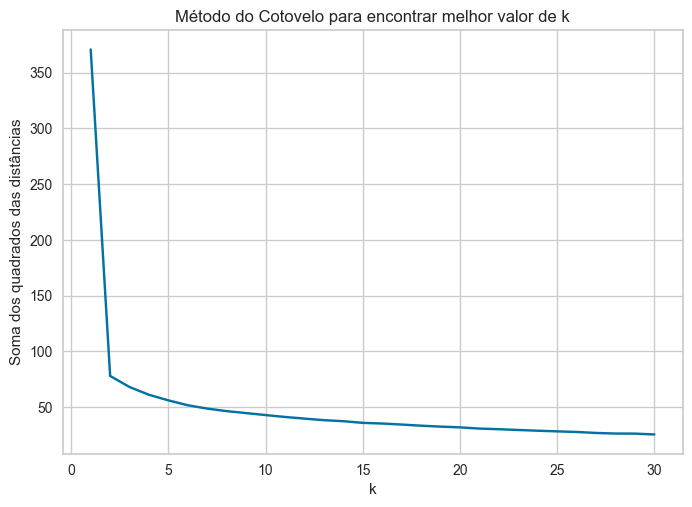

In [24]:
plt.plot(K, Sum_of_squared_distances, 'bx-')
plt.xlabel('k')
plt.ylabel('Soma dos quadrados das distâncias')
plt.title('Método do Cotovelo para encontrar melhor valor de k')
plt.show()

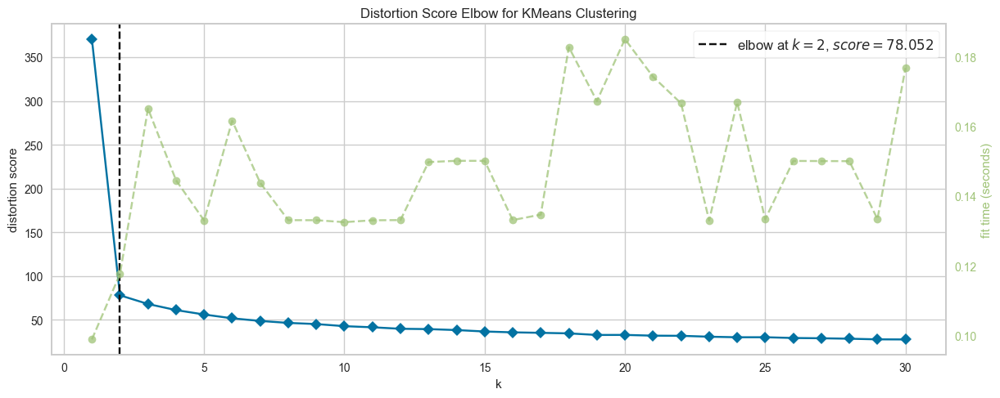

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [25]:
from yellowbrick.cluster import KElbowVisualizer
model = KMeans(n_init=20, init = 'random')
visualizer = KElbowVisualizer(model, k=K, size=(layout['width'], layout['height']))
visualizer.fit(df_transformedHVC)
visualizer.show()

In [26]:
kBest = visualizer.elbow_value_
print(kBest)

2


In [27]:
kmeans = KMeans(n_clusters = kBest, n_init = 20, init = 'random')
kmeans.fit(df_transformedHVC)
kmeans.cluster_centers_

array([[ 4.86417269e-01,  4.06996268e-01,  1.39451341e-01,
         9.49600487e-02,  8.81459275e-02,  4.87091489e-02,
         4.71831796e-01,  4.74624012e-01,  7.43084466e-02,
         6.31446641e-02,  6.07614845e-01, -1.38777878e-15,
         1.00000000e+00],
       [ 4.95146334e-01,  3.81266623e-01,  1.42022612e-01,
         6.89676610e-02,  5.97941793e-02,  3.09882247e-02,
         4.20784725e-01,  4.82805744e-01,  5.91000848e-02,
         4.00245185e-02,  5.95049082e-01,  1.00000000e+00,
         1.88737914e-15]])

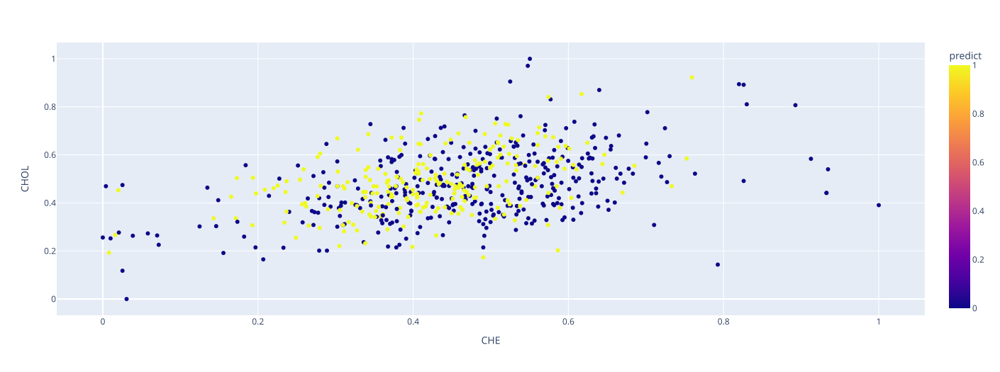

In [28]:
y_pred1 = kmeans.labels_
df_transformedHVC['predict'] = y_pred1
px.scatter(df_transformedHVC, x='CHE', y='CHOL', color='predict', **layout)

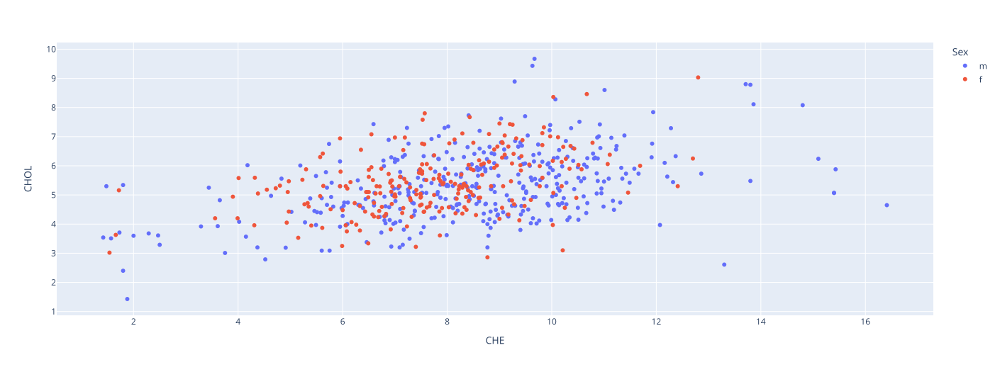

In [29]:
px.scatter(dfHVC, x='CHE', y='CHOL', color='Sex', **layout)

- Pelo que foi possível entender, o algoritmo encontrou o sexo da pessoa a partir do exame. 
- Porém, a informação estava como feature de entrada. Repetindo o método do cotovelo após remover o sexo, temos:

In [30]:
#normalizar os atributos contínuos com MinMaxScaler()
df_transformedHVC_alt = pd.DataFrame(df_transformedHVC)
del df_transformedHVC_alt['Sex_f']
del df_transformedHVC_alt['Sex_m']
del df_transformedHVC_alt['predict']

df_transformedHVC_alt.head()

,Age,ALB,ALP,ALT,AST,BIL,CHE,CHOL,CREA,GGT,PROT
0,0.224138,0.350669,0.101653,0.020962,0.036694,0.026461,0.367578,0.218447,0.091495,0.011757,0.535398
1,0.224138,0.350669,0.145571,0.052713,0.044990,0.012243,0.650434,0.408981,0.061619,0.017172,0.701327
2,0.224138,0.475483,0.156427,0.108816,0.134014,0.020932,0.494997,0.457524,0.072822,0.044400,0.763274
3,0.224138,0.420505,0.100419,0.091554,0.038290,0.071485,0.394263,0.401699,0.067221,0.045328,0.683628
4,0.224138,0.361070,0.154947,0.097719,0.045310,0.034755,0.515677,0.350728,0.063486,0.039295,0.528761


In [31]:
kmeans = KMeans(n_clusters = 2, n_init = 20, init = 'random')
kmeans.fit(df_transformedHVC_alt)
kmeans.cluster_centers_

array([[0.38574091, 0.41990282, 0.1348724 , 0.08859849, 0.06412149,
        0.03247833, 0.49502191, 0.48319667, 0.06663042, 0.04148674,
        0.62894642],
       [0.64693878, 0.36251023, 0.14886428, 0.07931755, 0.09688603,
        0.05600638, 0.38722141, 0.46962552, 0.07113   , 0.07339298,
        0.56319306]])

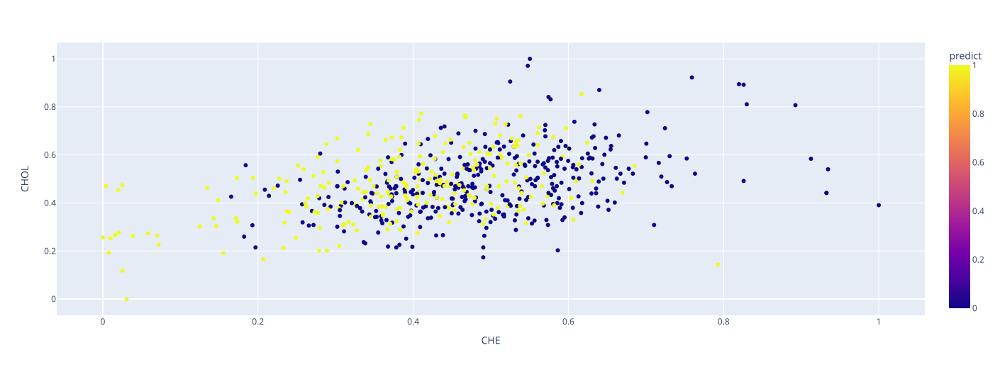

In [32]:
y_pred1 = kmeans.labels_
df_transformedHVC_alt['predict'] = y_pred1
px.scatter(df_transformedHVC_alt, x='CHE', y='CHOL', color='predict', **layout)

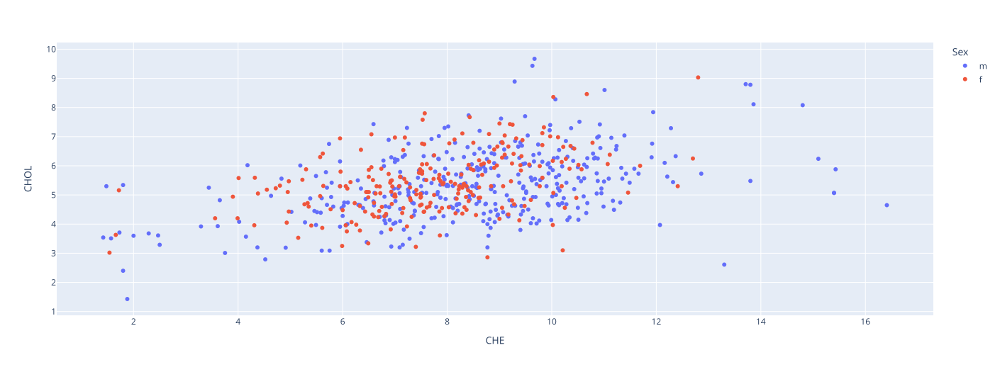

In [33]:
px.scatter(dfHVC, x='CHE', y='CHOL', color='Sex', **layout)

  - Pode-se ver que o algoritmo não reconheceu de fato o sexo a partir do exame, apenas classificou com base na feature de entrada.
  - A partir de agora, vou testar novamente alterando o peso de algumas features.

### Teste Alterando Pesos das features

In [34]:
df_transformedHVC_alt = pd.DataFrame(df_transformedHVC)
PESO_SEXO = 0.5
df_transformedHVC_alt['Sex_f'] = df_transformedHVC_alt['Sex_f']*PESO_SEXO
df_transformedHVC_alt['Sex_m'] = df_transformedHVC_alt['Sex_m']*PESO_SEXO
del df_transformedHVC_alt['predict']
del df_transformedHVC_alt['Age']

df_transformedHVC_alt.head()

,ALB,ALP,ALT,AST,BIL,CHE,CHOL,CREA,GGT,PROT,Sex_f,Sex_m
0,0.350669,0.101653,0.020962,0.036694,0.026461,0.367578,0.218447,0.091495,0.011757,0.535398,0.0,0.5
1,0.350669,0.145571,0.052713,0.044990,0.012243,0.650434,0.408981,0.061619,0.017172,0.701327,0.0,0.5
2,0.475483,0.156427,0.108816,0.134014,0.020932,0.494997,0.457524,0.072822,0.044400,0.763274,0.0,0.5
3,0.420505,0.100419,0.091554,0.038290,0.071485,0.394263,0.401699,0.067221,0.045328,0.683628,0.0,0.5
4,0.361070,0.154947,0.097719,0.045310,0.034755,0.515677,0.350728,0.063486,0.039295,0.528761,0.0,0.5


In [35]:
K = range(1,31)
Sum_of_squared_distances = []
for k in K:
    km = KMeans(n_clusters=k,n_init=20)
    km = km.fit(df_transformedHVC_alt)
    Sum_of_squared_distances.append(km.inertia_)

Determinar quais foram os melhores índices

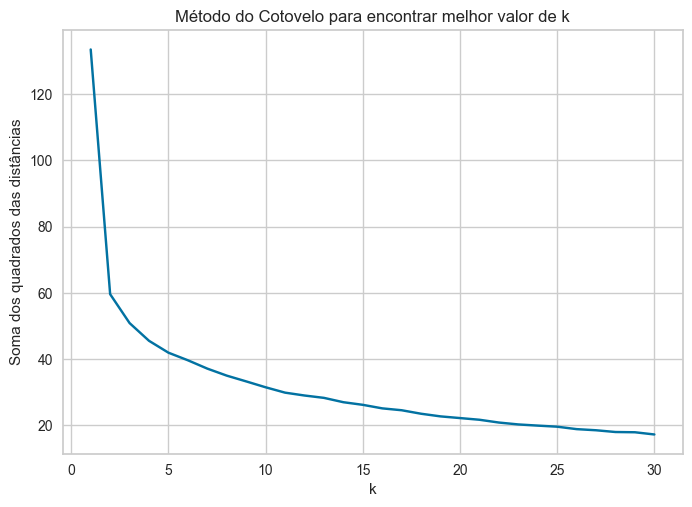

In [36]:
plt.plot(K, Sum_of_squared_distances, 'bx-')
plt.xlabel('k')
plt.ylabel('Soma dos quadrados das distâncias')
plt.title('Método do Cotovelo para encontrar melhor valor de k')
plt.show()

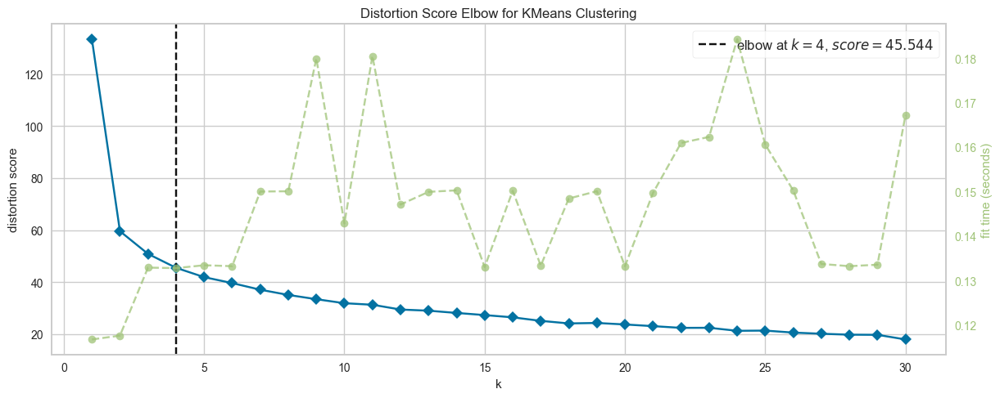

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [37]:
from yellowbrick.cluster import KElbowVisualizer
model = KMeans(n_init=20, init = 'random')
visualizer = KElbowVisualizer(model, k=K, size=(layout['width'], layout['height']))
visualizer.fit(df_transformedHVC_alt)
visualizer.show()

In [38]:
kBest = visualizer.elbow_value_
print(kBest)

4


In [39]:
kmeans = KMeans(n_clusters = kBest, n_init = 20, init = 'random')
kmeans.fit(df_transformedHVC_alt)
kmeans.cluster_centers_

array([[ 4.38057806e-01,  1.44015982e-01,  1.15196293e-01,
         7.85145233e-02,  3.66814452e-02,  5.77963804e-01,
         5.86462574e-01,  7.19790628e-02,  6.45550543e-02,
         6.69897231e-01, -3.05311332e-16,  5.00000000e-01],
       [ 3.81266623e-01,  1.42022612e-01,  6.89676610e-02,
         5.97941793e-02,  3.09882247e-02,  4.20784725e-01,
         4.82805744e-01,  5.91000848e-02,  4.00245185e-02,
         5.95049082e-01,  5.00000000e-01,  9.43689571e-16],
       [ 2.40118871e-01,  1.56595115e-01,  6.25893958e-02,
         3.39566050e-01,  2.23633491e-01,  1.43108739e-01,
         2.93932039e-01,  8.52245355e-02,  2.22116337e-01,
         4.40000000e-01,  8.32667268e-17,  5.00000000e-01],
       [ 4.03734321e-01,  1.33684267e-01,  8.31460815e-02,
         6.38178290e-02,  3.59740499e-02,  4.30043041e-01,
         4.09559657e-01,  7.47559201e-02,  4.18608961e-02,
         5.79881856e-01, -3.88578059e-16,  5.00000000e-01]])

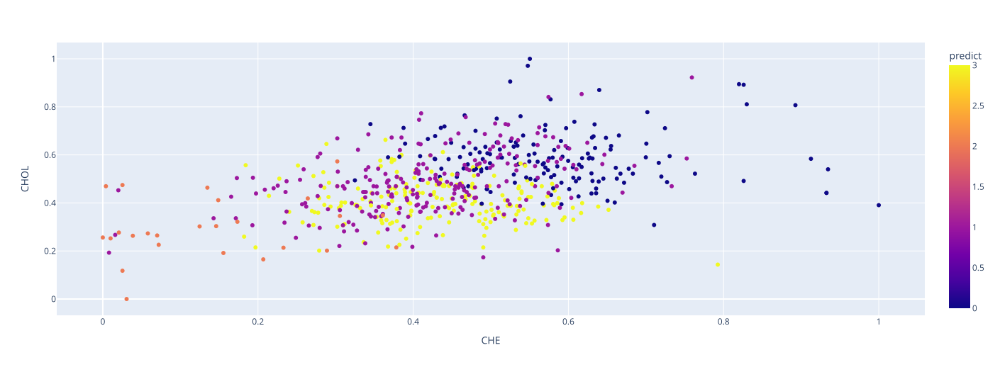

In [40]:
y_pred1 = kmeans.labels_
df_transformedHVC_alt['predict'] = y_pred1
px.scatter(df_transformedHVC_alt, x='CHE', y='CHOL', color='predict', **layout)

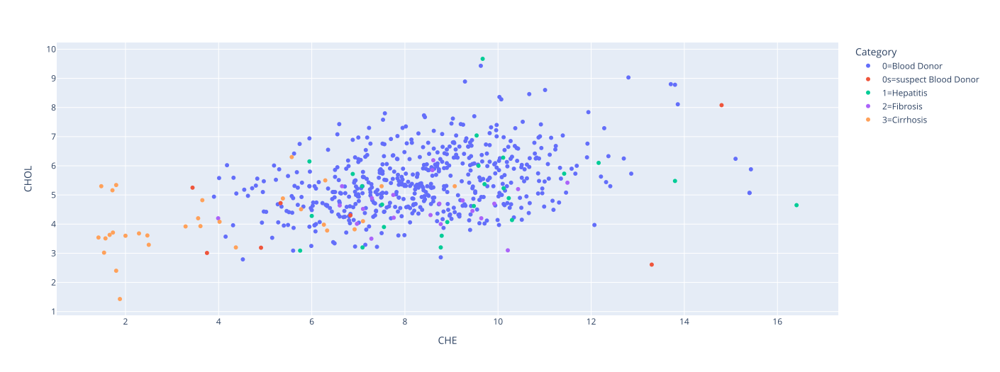

In [41]:
px.scatter(dfHVC, x='CHE', y='CHOL', color='Category', **layout)